# 数据集基本介绍

train.csv <br>
    ·image_id:不带扩展名的文件名，用于唯一标识每个映像  
    ·labels:包含给定图像的所有标签的字符串。 这可以用来在图像上的每个字符周围绘制一个边界框。 该字符串包含每个Unicode字符、x坐标、y坐标、Width和height。这些信息以空格分隔。  

sample_submission.csv  <br>
    ·image_id:不带扩展名的文件名，用于唯一标识每个映像  <br>
    ·labels 

unicode_translations.csv <br> 
    ·映射unicode ID和日文字符  
 
train_images.zip  <br>
    ·训练图像，train.csv 有关于每张图片上面的每个Kuzushiji字符的信息  
 
test_images.zip  <br>
    ·测试图像。 我们的任务是定位图像上的每个字符，然后对它们进行分类。 

可视化结果：
https://www.kaggle.com/code/wakamezake/kuzushiji-pytorch-data-preprocessing/notebook <br>
https://www.kaggle.com/code/anokas/kuzushiji-visualisation/notebook<br>

没尝试的:<br>
未尝试的可视化：https://www.kaggle.com/code/christianwallenwein/visualization-useful-functions-small-eda<br>
完整流程：https://www.kaggle.com/code/jesucristo/kuzushiji-recognition-complete-guide/comments

## 导包&基础准备

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont
from pathlib import Path
from os import listdir
import torch
import torch.nn.functional as F
from torch import nn
from torch.utils.data import DataLoader
from torch.utils.data import Dataset
import torchvision
import torchvision.transforms as transforms
from torch.autograd import Variable
%matplotlib inline

In [5]:
# 展示数据集
%ls "D:\桌面\Kuzushiji\数据集\kuzushiji-recognition"

 驱动器 D 中的卷是 Data
 卷的序列号是 A29D-44C8

 D:\桌面\Kuzushiji\数据集\kuzushiji-recognition 的目录

2023/06/21  23:28    <DIR>          .
2023/06/26  16:31    <DIR>          ..
2023/05/22  15:29       199,190,110 Kuzushiji_split_by_book_annotation_train.json
2019/12/11  03:50            75,573 sample_submission.csv
2023/05/18  21:07            10,392 test.csv
2023/05/18  11:58    <DIR>          test_images
2019/12/11  03:51     1,477,306,825 test_images.zip
2019/12/11  03:53        15,672,313 train.csv
2019/12/11  03:53     3,019,402,077 train_images.zip
2023/05/20  15:59            52,712 unicode_translation.csv
2023/05/20  15:59            52,712 unicode_translation_number.csv
2023/06/19  15:24     1,701,341,181 修正后的test.zip
               9 个文件  6,413,103,895 字节
               3 个目录 28,773,765,120 可用字节


魔术命令是常规python代码的增强，通常以“%”字符为前缀。这些命令由IPython内核提供，基本上是为了解决常见问题而添加的，同时也为代码提供了一些快捷方式。
https://blog.csdn.net/weixin_44322234/article/details/106282773?spm=1001.2101.3001.6650.2&utm_medium=distribute.pc_relevant.none-task-blog-2%7Edefault%7ECTRLIST%7ERate-2-106282773-blog-107348199.235%5Ev36%5Epc_relevant_default_base&depth_1-utm_source=distribute.pc_relevant.none-task-blog-2%7Edefault%7ECTRLIST%7ERate-2-106282773-blog-107348199.235%5Ev36%5Epc_relevant_default_base&utm_relevant_index=3

!开一个新的progress,执行完之后立即终止；provided by the Jupyter<br>
%的操作会持续；provided by the IPython kernel

## 读取数据

train.csv有两列，一列是照片id，另一列是该照片上的所有目标（文字）的bbox和对应类别unicode。某一列的形式如下：
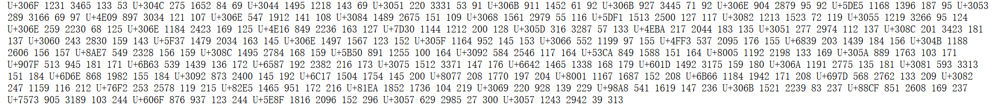
可以看到一列字很多，所以那一格子放不下<br>
字符串应该作为空格分隔的一系列值来读取，其中Unicode字符，X, Y, Width和Height根据需要重复多次。

In [6]:
# 创建一个路径对象Path存储数据集位置，详见py基础
input_path = Path("D:\桌面\Kuzushiji\数据集\kuzushiji-recognition")

In [7]:
# reference：https://www.kaggle.com/anokas/kuzushiji-visualisation
df_train = pd.read_csv( input_path / 'train.csv') # 读取训练集annotation
df_train.head()

,image_id,labels
0,100241706_00004_2,U+306F 1231 3465 133 53 U+304C 275 1652 84 69 ...
1,100241706_00005_1,U+306F 1087 2018 103 65 U+304B 1456 1832 40 73...
2,100241706_00005_2,U+306F 572 1376 125 57 U+306E 1551 2080 69 68 ...
3,100241706_00006_1,U+3082 1455 3009 65 44 U+516B 1654 1528 141 75...
4,100241706_00007_2,U+309D 1201 2949 27 33 U+309D 1196 1539 27 36 ...


unicode_trans 表unicode和日语之间的转换关系，目前是乱码待解决。<br>
另外也保存train_images 和 test_images的目录

In [8]:
unicode_trans = pd.read_csv( input_path / 'unicode_translation.csv')
train_image_path = input_path / "train_images"
test_image_path = input_path / "test_images"
unicode_trans.head()

,Unicode,char
0,U+0031,1
1,U+0032,2
2,U+0034,4
3,U+0036,6
4,U+0039,9


### unicode相关
unicode是计算机科学领域里的一项业界标准，包括字符集、编码方案等。计算机采用八比特一个字节，一个字节最大整数是255，还要表示中文一个字也是不够的，至少需要两个字节，为了统一所有的文字编码，unicode为每种语言中的每个字符设定了统一并且唯一的二进制编码，通常用两个字节表示一个字符，所以unicode每个平面可以组合出65535种不同的字符，一共17个平面。

unicode在计算机中如何存储呢，就是用unicode字符集转换格式，即我们常见的UTF-8、UTF-16等。UTF-8就是以字节为单位对unicode进行编码，对不同范围的字符使用不同长度的编码。
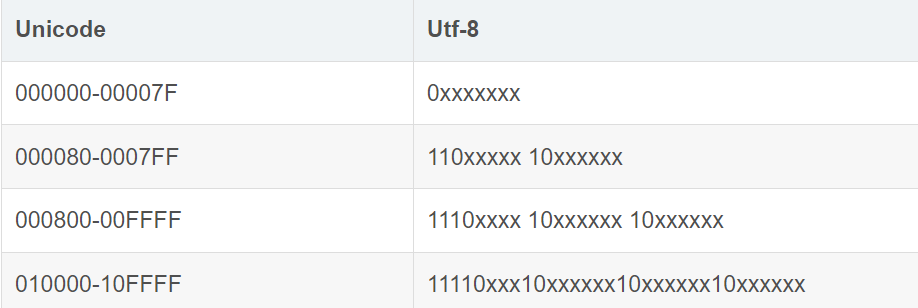

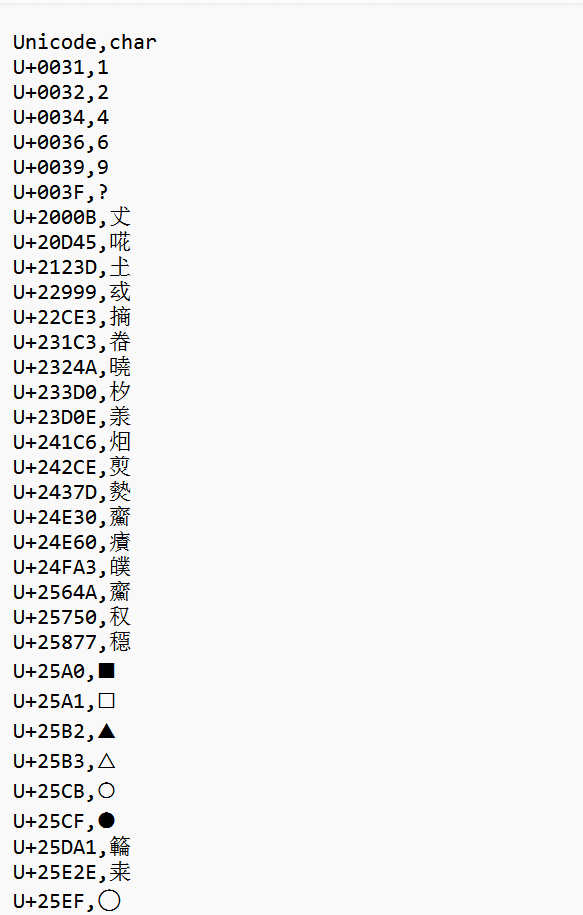
本项目的unicode编码对应，在excel里面打开会乱码

在Unicode中，对于每一个字符编码的值，叫做code point。例如小写字母a的code point为97，对应十六进制为\x61。在ASCII编码中，字符"A"对应的codepoint是65（十进制）。而在Unicode编码中，字符"A"的codepoint是U+0041（十六进制）。

下面一个代码构建了一个字典，把codepoint和对应的字符值映射起来。其中unicode_trans.values返回的是unicode_trans中所有行的数据，每行包含了"Unicode"列和"char"列的值。根据代码中的写法，codepoint代表"Unicode"列中的值，而char代表"char"列中的值。

字典推导式是一种简洁的语法，用于从可迭代的数据中创建字典。它的基本语法是 {key_expression: value_expression for item in iterable}，其中 key_expression 是用于生成键的表达式，value_expression 是用于生成值的表达式，item 是可迭代对象中的每个元素。

冒号（:）：冒号在字典中用于分隔键和值。在字典推导式中，冒号用于分隔键表达式和值表达式。通过冒号将键和值分隔开，可以构建字典的键值对。例如，下面是一个简单的示例，演示了如何使用字典推导式和冒号创建一个字典：

In [9]:
numbers = [1, 2, 3, 4, 5]
square_dict = {num: num**2 for num in numbers}
print(square_dict)

{1: 1, 2: 4, 3: 9, 4: 16, 5: 25}


In [10]:
# 通过迭代每个数据项来构建unicode_map字典，其中的键是codepoint列的值，而值是char列的值。
# 真正标准的写法是：unicode_map = {(codepoint: char) for (codepoint, char) in unicode_trans.values}
unicode_map = {codepoint: char for codepoint, char in unicode_trans.values} # .values用于返回DataFrame中的数据部分（即值），即每一行的数据。

In [11]:
# 输出前五行数据
for codepoint, char in list(unicode_map.items())[:5]:
    print(codepoint, char)

U+0031 1
U+0032 2
U+0034 4
U+0036 6
U+0039 9


在这个示例中，假设已经通过代码创建了unicode_map字典。我们使用list(unicode_map.items())[:5]来获取字典的前五个键值对，然后通过循环遍历输出每个键（codepoint）和对应的值（char）。这样就可以将前五行数据打印出来。

请注意，字典在Python中是无序的，因此输出的顺序可能与代码中创建字典的顺序不完全相同。如果需要按照特定的顺序输出，可以使用collections.OrderedDict或将键进行排序的其他技术。

### 拆分训练集标注
string.split(separator, maxsplit)，其中：<br>
separator（可选）：指定用于分割字符串的分隔符。如果未提供分隔符，则默认使用空格字符。<br>
maxsplit（可选）：指定拆分的最大次数。默认情况下，将拆分整个字符串。如果提供了 maxsplit 参数，则最多进行 maxsplit 次拆分。<br>

该方法返回一个列表，其中包含分割后的子字符串。可以使用索引访问列表中的每个子字符串。

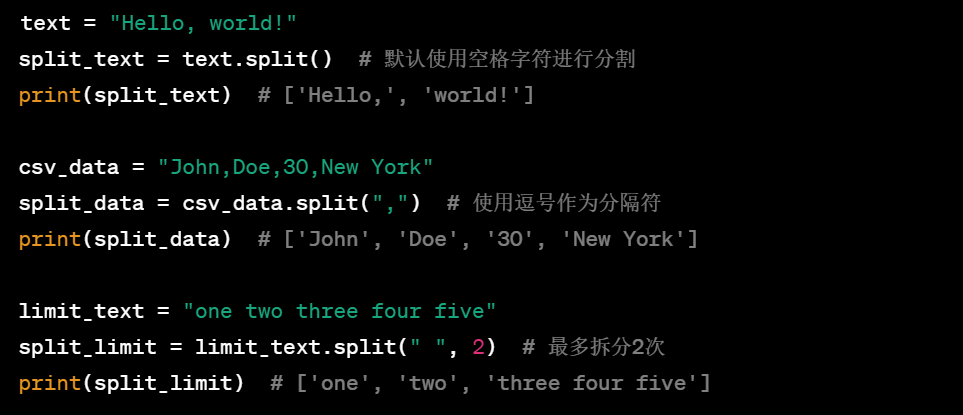

回顾：df_train的形式：
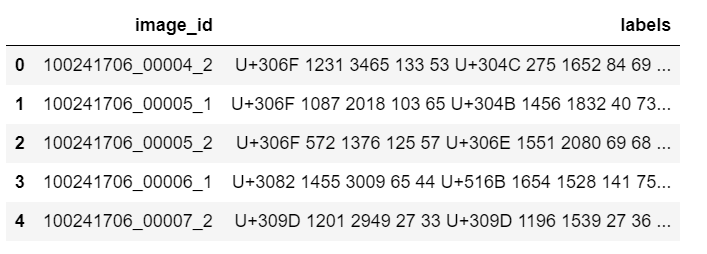
label列中的每一个元素里都是对应左边照片中的所有汉字包含的bbox和分类unicode信息。这里我们取label列第一行那一坨，然后输出前五个字符看看。

In [12]:
length = 5 # 因为所有照片上的字都写在一行里面，我们得五个五个取，每五个表示一个字的位置。
# 从"df_train" DataFrame的"labels"列中获取标签，并使用split()方法将其拆分为单独的元素。拆分后的元素存储在"split_labels"列表中。
split_labels = df_train["labels"][0].split() #[0]表示用于获取该列的第一个元素
for idx in range(len(split_labels) // length):
    start_idx = idx * length # 打印从"start_idx"开始，直到"start_idx + length"为止的标签块。
    print(split_labels[start_idx : start_idx + length])
    if idx == 4: # 如果当前索引等于4，则跳出循环。说白了就是展示前0-4五行
        break

['U+306F', '1231', '3465', '133', '53']
['U+304C', '275', '1652', '84', '69']
['U+3044', '1495', '1218', '143', '69']
['U+3051', '220', '3331', '53', '91']
['U+306B', '911', '1452', '61', '92']


## 定义数据集对象

这段代码定义了一个名为 KuzushijiDataset 的自定义数据集类，用于加载和处理 Kuzushiji 数据集的图像数据。使用 glob() 方法在 img_path 路径下查找所有以 ".jpg" 结尾的图像文件，并将它们保存在 img_paths 列表中。

glob() 方法是 pathlib 模块中的方法之一。glob() 方法用于查找匹配指定模式的文件路径。它返回一个生成器，可以遍历满足匹配模式的文件路径。该方法可以用于文件路径的搜索和筛选。用法：path.glob(pattern)，其中，path 是一个 Path 对象，表示要搜索的文件路径，而 pattern 是一个字符串模式，用于匹配文件名。模式可以包含通配符，如 * 和 ?，以及字符范围 [ ] 等。
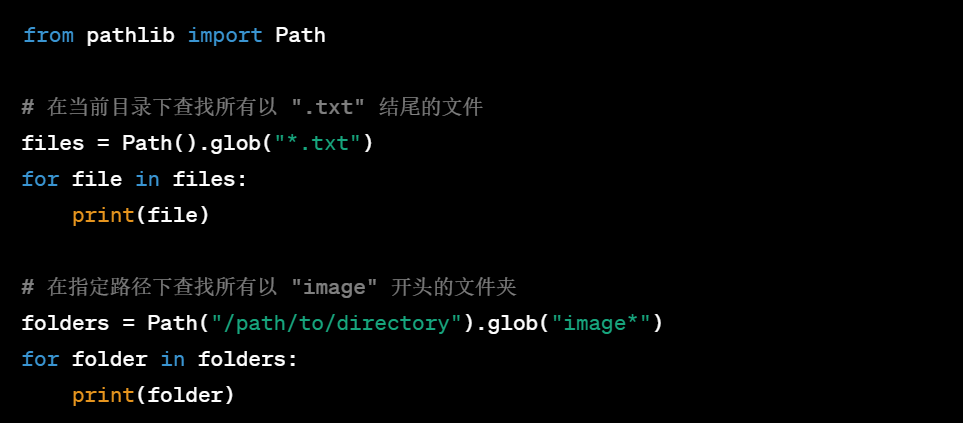
需要注意的是，glob() 方法返回的是一个生成器对象，而不是列表。如果需要将结果存储为列表，可以使用 list() 函数进行转换。

### 什么是生成器？
生成器（Generator）是一种特殊的迭代器（Iterator），它是一种用于惰性计算（Lazy Evaluation）的对象。与一次性生成所有数据的列表不同，生成器在需要时逐个生成数据，并且只在需要时占用有限的内存空间。

生成器的主要优势有：

延迟计算：生成器只在需要时生成数据，可以节省内存空间，并且在处理大量数据或无限序列时非常高效。<br>
迭代操作：生成器可以像迭代器一样使用，可以使用 next() 函数或迭代语句（如 for 循环）逐个访问生成器的元素。<br>
简洁性：通过生成器可以使用更简洁的代码来表示迭代过程，避免一次性生成大量数据。<br>

下面是一个使用生成器的简单示例，其中 range() 函数本身就是一个生成器：
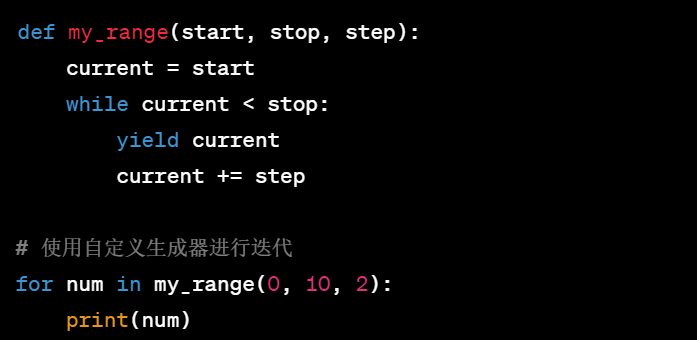
需要注意的是，生成器只能进行顺序迭代，无法进行索引访问或回溯。一旦生成器的元素被迭代完毕，它就无法再次使用。如果需要多次使用生成器的值，可以将生成器转换为列表或其他可重复访问的数据结构。

zip() 是一个 Python 内置函数，用于将多个可迭代对象按位置配对，返回一个生成器，生成配对后的元组。

具体来说，zip() 函数接受任意数量的可迭代对象作为参数，可以是列表、元组、字符串或其他可迭代对象。它将这些可迭代对象中相同位置的元素配对，并生成一个新的迭代器（生成器），生成的每个元素都是一个元组，包含了来自每个可迭代对象的对应位置的值。
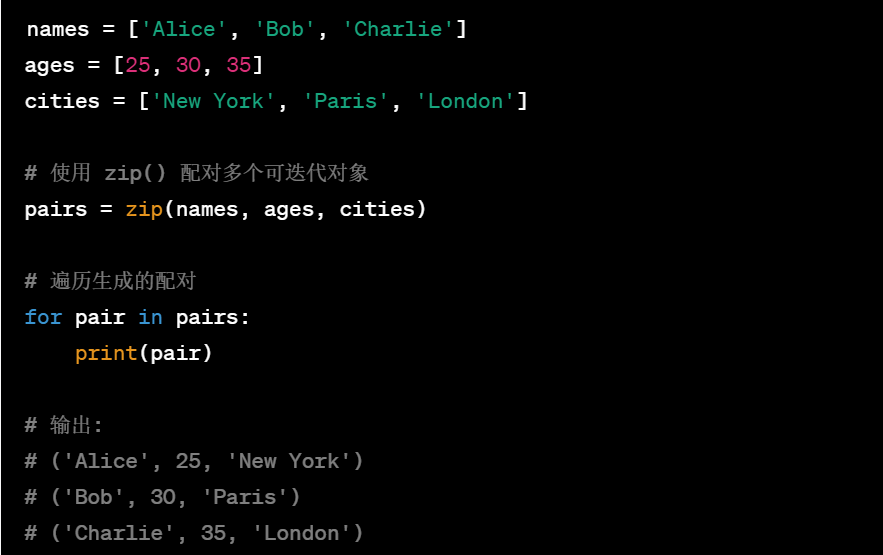


keys() 是字典（dict）对象的一个方法，用于返回字典中所有的键（keys）。
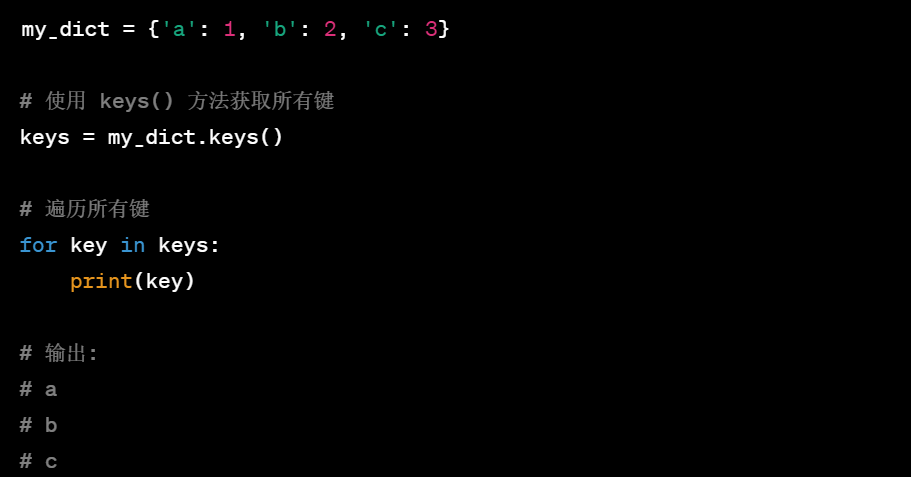
在给定的代码中，self.unicode_map.keys() 返回了 self.unicode_map 字典中所有的键。这个可迭代对象被用作 zip() 函数的第一个参数，与另一个可迭代对象配对，用于创建 self.unicode2labels 字典的键。

assert type(image_id) == str 是一条断言语句，用于在代码执行过程中进行断言检查。

断言是一种用于验证代码假设的表达式。在这个特定的断言语句中，它检查变量 image_id 的类型是否为字符串 (str)。如果断言的条件为真，则程序会继续执行。如果断言的条件为假，则会引发 AssertionError 异常，中断程序的执行。

这条断言语句的目的是确保 image_id 的类型为字符串。如果在调用 get_label_and_mask 方法时传递了一个不是字符串的参数，那么断言会触发异常，提示代码中存在错误，并提醒开发者传递正确的参数类型。

### 测试
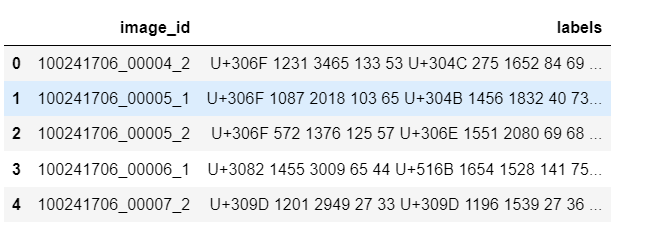

In [13]:
mask = pd.read_csv(input_path/"train.csv")
split_labels = mask[mask["image_id"] == "100241706_00004_2"]["labels"].str.split(" ").values[0]
split_labels

['U+306F',
 '1231',
 '3465',
 '133',
 '53',
 'U+304C',
 '275',
 '1652',
 '84',
 '69',
 'U+3044',
 '1495',
 '1218',
 '143',
 '69',
 'U+3051',
 '220',
 '3331',
 '53',
 '91',
 'U+306B',
 '911',
 '1452',
 '61',
 '92',
 'U+306B',
 '927',
 '3445',
 '71',
 '92',
 'U+306E',
 '904',
 '2879',
 '95',
 '92',
 'U+5DE5',
 '1168',
 '1396',
 '187',
 '95',
 'U+3053',
 '289',
 '3166',
 '69',
 '97',
 'U+4E09',
 '897',
 '3034',
 '121',
 '107',
 'U+306E',
 '547',
 '1912',
 '141',
 '108',
 'U+3084',
 '1489',
 '2675',
 '151',
 '109',
 'U+3068',
 '1561',
 '2979',
 '55',
 '116',
 'U+5DF1',
 '1513',
 '2500',
 '127',
 '117',
 'U+3082',
 '1213',
 '1523',
 '72',
 '119',
 'U+3055',
 '1219',
 '3266',
 '95',
 '124',
 'U+306E',
 '259',
 '2230',
 '68',
 '125',
 'U+306E',
 '1184',
 '2423',
 '169',
 '125',
 'U+4E16',
 '849',
 '2236',
 '163',
 '127',
 'U+7D30',
 '1144',
 '1212',
 '200',
 '128',
 'U+305D',
 '316',
 '3287',
 '57',
 '133',
 'U+4EBA',
 '217',
 '2044',
 '183',
 '135',
 'U+3051',
 '277',
 '2974',
 '112',
 '137'

In [14]:
split_labels = mask[mask["image_id"] == "100241706_00004_2"]["labels"].str.split(" ")
split_labels

0    [U+306F, 1231, 3465, 133, 53, U+304C, 275, 165...
Name: labels, dtype: object

In [15]:
# 使用values变成一个列表套数组的形式了，所以我们需要values[0]
split_labels = mask[mask["image_id"] == "100241706_00004_2"]["labels"].str.split(" ").values
split_labels 

array([list(['U+306F', '1231', '3465', '133', '53', 'U+304C', '275', '1652', '84', '69', 'U+3044', '1495', '1218', '143', '69', 'U+3051', '220', '3331', '53', '91', 'U+306B', '911', '1452', '61', '92', 'U+306B', '927', '3445', '71', '92', 'U+306E', '904', '2879', '95', '92', 'U+5DE5', '1168', '1396', '187', '95', 'U+3053', '289', '3166', '69', '97', 'U+4E09', '897', '3034', '121', '107', 'U+306E', '547', '1912', '141', '108', 'U+3084', '1489', '2675', '151', '109', 'U+3068', '1561', '2979', '55', '116', 'U+5DF1', '1513', '2500', '127', '117', 'U+3082', '1213', '1523', '72', '119', 'U+3055', '1219', '3266', '95', '124', 'U+306E', '259', '2230', '68', '125', 'U+306E', '1184', '2423', '169', '125', 'U+4E16', '849', '2236', '163', '127', 'U+7D30', '1144', '1212', '200', '128', 'U+305D', '316', '3287', '57', '133', 'U+4EBA', '217', '2044', '183', '135', 'U+3051', '277', '2974', '112', '137', 'U+308C', '201', '3423', '181', '137', 'U+3060', '243', '2830', '159', '143', 'U+5F37', '1479', '203

In [16]:
split_labels[0]

['U+306F',
 '1231',
 '3465',
 '133',
 '53',
 'U+304C',
 '275',
 '1652',
 '84',
 '69',
 'U+3044',
 '1495',
 '1218',
 '143',
 '69',
 'U+3051',
 '220',
 '3331',
 '53',
 '91',
 'U+306B',
 '911',
 '1452',
 '61',
 '92',
 'U+306B',
 '927',
 '3445',
 '71',
 '92',
 'U+306E',
 '904',
 '2879',
 '95',
 '92',
 'U+5DE5',
 '1168',
 '1396',
 '187',
 '95',
 'U+3053',
 '289',
 '3166',
 '69',
 '97',
 'U+4E09',
 '897',
 '3034',
 '121',
 '107',
 'U+306E',
 '547',
 '1912',
 '141',
 '108',
 'U+3084',
 '1489',
 '2675',
 '151',
 '109',
 'U+3068',
 '1561',
 '2979',
 '55',
 '116',
 'U+5DF1',
 '1513',
 '2500',
 '127',
 '117',
 'U+3082',
 '1213',
 '1523',
 '72',
 '119',
 'U+3055',
 '1219',
 '3266',
 '95',
 '124',
 'U+306E',
 '259',
 '2230',
 '68',
 '125',
 'U+306E',
 '1184',
 '2423',
 '169',
 '125',
 'U+4E16',
 '849',
 '2236',
 '163',
 '127',
 'U+7D30',
 '1144',
 '1212',
 '200',
 '128',
 'U+305D',
 '316',
 '3287',
 '57',
 '133',
 'U+4EBA',
 '217',
 '2044',
 '183',
 '135',
 'U+3051',
 '277',
 '2974',
 '112',
 '137'

In [17]:
split_labels[1]

IndexError: index 1 is out of bounds for axis 0 with size 1

In [40]:
split_labels = mask[mask["image_id"] == "100241706_00004_2"]["labels"].str.split(" ").values[1]
split_labels

IndexError: index 1 is out of bounds for axis 0 with size 1

In [ ]:
df = pd.DataFrame({'Weight':[45, 88, 56, 15, 71], 
                   'Name':['Sam', 'Andrea', 'Alex', 'Robin', 'Kia'], 
                   'Age':[14, 25, 55, 8, 21]}) 

 

In [51]:
class KuzushijiDataset(Dataset):
    def __init__(self, img_path, mode="train"):
        self.img_path = img_path # 之前定义的数据集地址
        # glob("*jpg") 使用通配符 "*" 匹配所有文件名，并指定后缀为 ".jpg"。使用 list() 函数将返回的生成器对象转换为列表。
        self.img_paths = list(self.img_path.glob("*jpg")) # 在 img_path下搜索所有.jpg结尾的文件，把他们的地址组成list。
        self.unicode_trans = pd.read_csv( input_path / 'unicode_translation.csv')
        # 前面说过的，unicode和日文字符的对应字典，key是codepoint
        self.unicode_map = {codepoint: char for codepoint, char in unicode_trans.values} 
        
        # 创建了一个名为 self.unicode2labels 的字典。创建了一个从unicode(或者说codepoint)到0，1，2....len(keys)-1的映射
        self.unicode2labels = dict(zip(self.unicode_map.keys(), # zip将 self.unicode_map.keys() 和 range(len(self.unicode_map.keys())) 这两个可迭代对象按位置配对，生成了一个元组序列
                                      range(len(self.unicode_map.keys())))) # 由于是生成器，还得加dict变成字典形式。
        self.label_length = 5
        self.transform = transforms.ToTensor()
        
        # 定义对象时，需要输入参数mode，如果是train（默认）则是训练集，反之测试集。
        if mode == "train":
            self.mode = "train"
            self.mask = pd.read_csv( input_path / 'train.csv')# 读入训练集每张照片上对应的字符以及位置。
        else:
            self.mode = "test"
    
    def get_label_and_mask(self, image_id):
        # assert type(image_id) == str # 断言检查，如果传入的image_id是非字符串就报错。
        
        # self.mask就是我们之前训练集的annotation标注，train_csv。第一列是image_id，第二列是labels
        # 按要求 self.mask["image_id"] == image_id 来挑选行，也就是说给定的image_id在train.csv表里搜寻,找到相对应的照片所在的行。
        # 之后选取该照片所在行的"labels"列（存放的是字符的bbox位置和unicode），这是n多个“五元组”：unicode x y w h unicode2 x2 y2 w2 h2 ...
        # .str.split(" ")：对选取的 "labels" 列进行字符串拆分操作，使用空格作为分隔符。
        split_labels = self.mask[self.mask["image_id"] == image_id]["labels"].str.split(" ").values[0] # 用values[0]获取对应行组成的列表
        ll = len(split_labels) // length # 获得字符个数（因为每五个是一个字）
        
        masks = np.zeros((ll, 4)) # 创建一个形状为 (ll, 4) 的全零矩阵，用于存储该页上字符生成的掩码（masks）。ll是LL的小写，不是十一！！！
        labels = np.zeros((ll)) # 创建一个形状为 (ll,) 的全零数组，用于存储生成的标签（labels）。
        
        for idx in range(ll):
            start_idx = idx * self.label_length
            labels[idx] = self.unicode2labels[split_labels[start_idx]]
            masks[idx] = split_labels[start_idx+1:start_idx+self.label_length]
        return labels, masks
    
    def __getitem__(self, index):
        """ Get a sample from the dataset
        """
        img_path = self.img_paths[index]
        image = Image.open(img_path)
        if self.mode == "train":
            labels, masks = self.get_label_and_mask(img_path.stem)
#             data = {"image": np.array(image), "mask": masks}
#         else:
#             data = {"image": np.array(image)}
#         transformed = self.transform(**data)
#         image = transformed['image'] / 255
#         image = np.transpose(image, (2, 0, 1))
        if self.mode == 'train':
            return self.transform(image), labels, masks
        else:
            return image

    def __len__(self):
        """
        Total number of samples in the dataset
        """
        return len(self.img_paths)

In [52]:
k_train = KuzushijiDataset(img_path=train_image_path)

In [53]:
print(k_train.get_label_and_mask("100241706_00004_2"))

(array([  92.,   57.,   52.,   62.,   88.,   88.,   91., 1255.,   64.,
        251.,   91.,  113.,   85., 1261.,  111.,   66.,   91.,   91.,
        259., 3041.,   74.,  316.,   62.,  121.,   77., 1365.,   91.,
         76.,   83.,  406., 1977.,   56., 3824.,  121., 1083.,  126.,
        685., 3175.,   71., 4102., 2150., 1782.,   98., 1834., 1435.,
         87.,  110., 2264.,  126., 2191., 3199., 3172., 2152., 2061.,
        111., 2708., 3353., 3283.,   86., 4440.,   88., 3698., 2622.,
       1460., 1310.,   68.,   68.]), array([[1231., 3465.,  133.,   53.],
       [ 275., 1652.,   84.,   69.],
       [1495., 1218.,  143.,   69.],
       [ 220., 3331.,   53.,   91.],
       [ 911., 1452.,   61.,   92.],
       [ 927., 3445.,   71.,   92.],
       [ 904., 2879.,   95.,   92.],
       [1168., 1396.,  187.,   95.],
       [ 289., 3166.,   69.,   97.],
       [ 897., 3034.,  121.,  107.],
       [ 547., 1912.,  141.,  108.],
       [1489., 2675.,  151.,  109.],
       [1561., 2979.,   55.,

In [47]:
df = pd.DataFrame({'Weight':[45, 88, 56, 15, 71], 
                   'Name':['Sam', 'Andrea', 'Alex', 'Robin', 'Kia'], 
                   'Age':[14, 25, 55, 8, 21]}) 
 
# Print the DataFrame 
df.head()

,Weight,Name,Age
0,45,Sam,14
1,88,Andrea,25
2,56,Alex,55
3,15,Robin,8
4,71,Kia,21


In [48]:
# values返回的是一个数组 ，数组里面包含所有“值”（键值对儿中的值）列表。
# 即只返回{key0:value0,key1:value1,...}中的[value0、value1……]
df.values # 注意：这里是一个套娃！数组套列表！

array([[45, 'Sam', 14],
       [88, 'Andrea', 25],
       [56, 'Alex', 55],
       [15, 'Robin', 8],
       [71, 'Kia', 21]], dtype=object)

In [49]:
df.values[0]

array([45, 'Sam', 14], dtype=object)

In [50]:
df.values[1]

array([88, 'Andrea', 25], dtype=object)

## 可视化
This function takes in a filename of an image, and the labels in the string format given in train.csv, and returns an image containing the bounding boxes and characters annotated
该函数接受图像的文件名和train.csv中给出的字符串格式的标签，并返回包含边界框和带注释的字符的图像

In [2]:
# reference: https://www.kaggle.com/anokas/kuzushiji-visualisation
def visualize_training_data(image_fn, masks):
    imsource = Image.fromarray(np.uint8(image_fn * 255)).convert('RGBA')
    bbox_canvas = Image.new('RGBA', imsource.size)
    bbox_draw = ImageDraw.Draw(bbox_canvas) # Separate canvases for boxes and chars so a box doesn't cut off a character 为盒子和字符分开画布，这样一个盒子就不会切断一个字符

    for idx in range(masks.shape[1]):
        x, y, w, h = masks[0][idx]
        x, y, w, h = int(x), int(y), int(w), int(h) #转化为int类型

        # Draw bounding box around character, and unicode character next to it
        bbox_draw.rectangle((x, y, x+w, y+h), # bbox计算法，还是x，y，x+w，y+h和coco一样
                            fill=(255, 255, 255, 0),
                            outline=(255, 0, 0, 255))
    imsource = Image.alpha_composite(imsource, bbox_canvas)
    imsource = imsource.convert("RGB") # Remove alpha for saving in jpg format.
    return np.asarray(imsource) #  Convert annotation string to array

In [3]:
batch_size = 1

# Use the torch dataloader to iterate through the dataset
loader = DataLoader(k_train, batch_size=batch_size, shuffle=False, num_workers=0)

# functions to show an image
def imshow(img):
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))

NameError: name 'k_train' is not defined

In [59]:
# get some images
dataiter = iter(loader)
images, label, masks  = dataiter.next() # 版本问题，把next()方法改成_ _next_ _()。
print("image.shape: {}".format(images.shape))
print("mask.shape: {}".format(masks.shape))

AttributeError: '_SingleProcessDataLoaderIter' object has no attribute 'next'

单张图片的信息
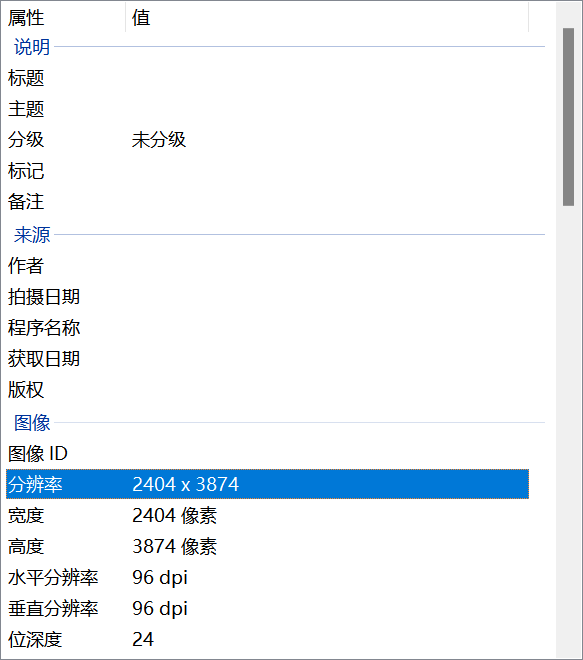

In [60]:
# get some images
dataiter = iter(loader)
images, label, masks  = next(dataiter) # 版本问题，把next()方法改成_ _next_ _()。
print("image.shape: {}".format(images.shape))
print("mask.shape: {}".format(masks.shape))

image.shape: torch.Size([1, 3, 3874, 2404])
mask.shape: torch.Size([1, 67, 4])


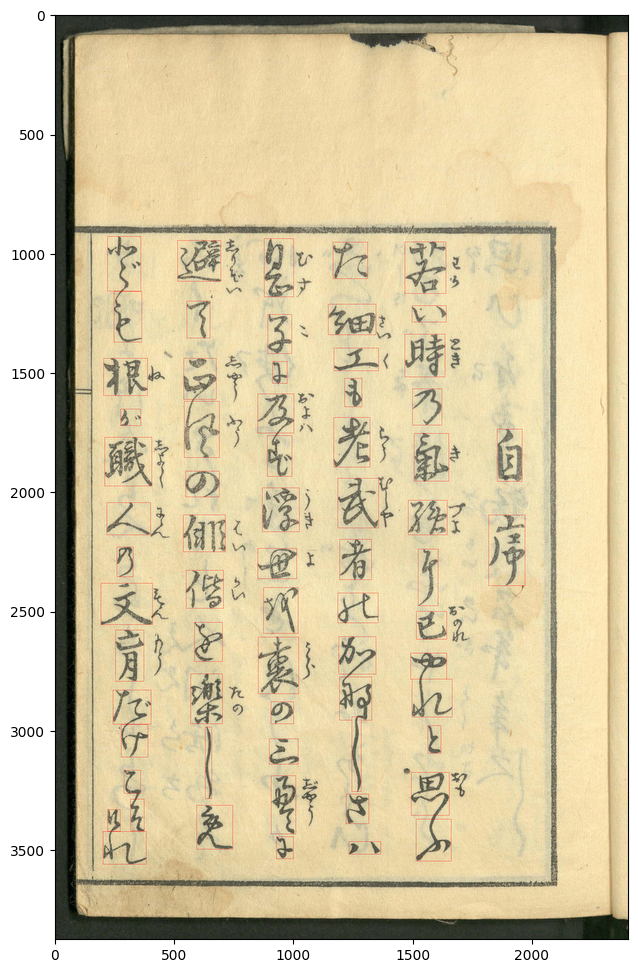

In [61]:
# show images
plt.figure(figsize=(12,12))
np_img = images.numpy()[0].transpose((1, 2, 0))
new_img = visualize_training_data(np_img, masks)
plt.imshow(new_img, interpolation='lanczos') # 插值算法之一，详见：https://blog.csdn.net/qq_41634283/article/details/84933753

image.shape: torch.Size([1, 3, 3874, 2392])
mask.shape: torch.Size([1, 80, 4])


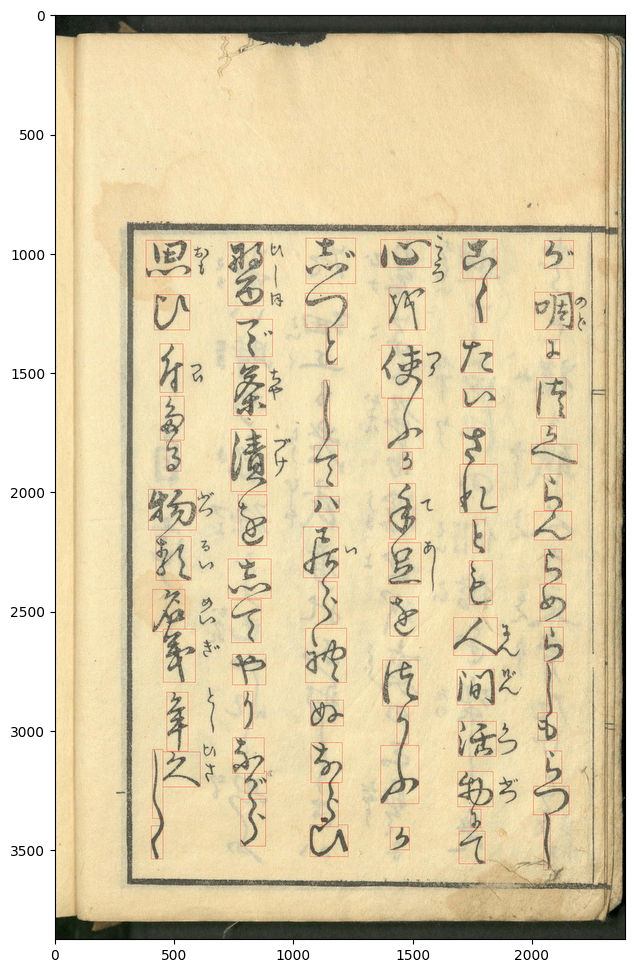

In [62]:
# 换下一张图片
images, label, masks  = next(dataiter) # 版本问题，把next()方法改成_ _next_ _()。
print("image.shape: {}".format(images.shape))
print("mask.shape: {}".format(masks.shape))

# show images
plt.figure(figsize=(12,12))
np_img = images.numpy()[0].transpose((1, 2, 0))
new_img = visualize_training_data(np_img, masks)
plt.imshow(new_img, interpolation='lanczos')

image.shape: torch.Size([1, 3, 3874, 2416])
mask.shape: torch.Size([1, 78, 4])


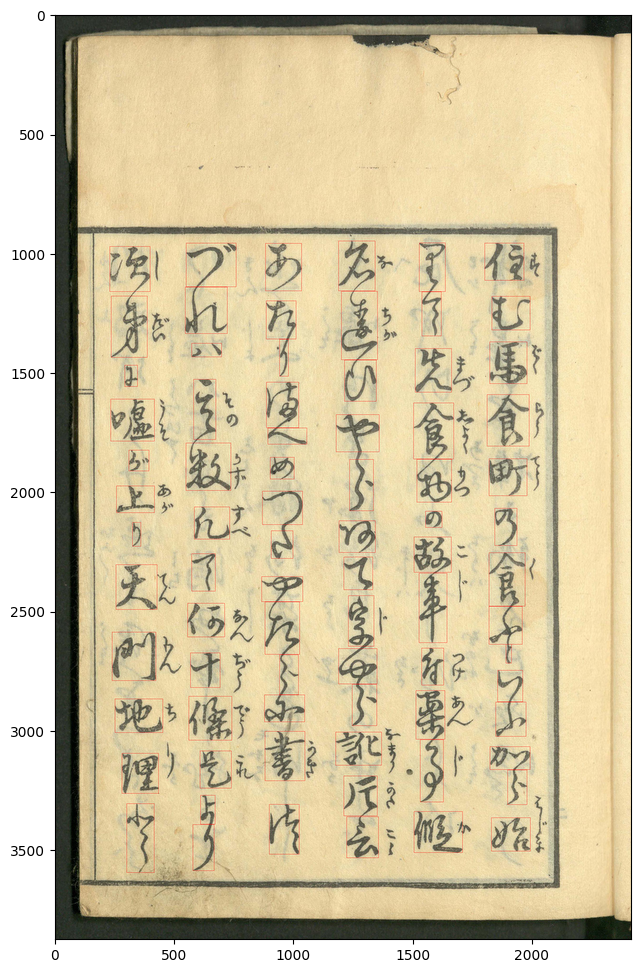

In [63]:
# 再来，可以遍历所有照片
images, label, masks  = next(dataiter) # 版本问题，把next()方法改成_ _next_ _()。
print("image.shape: {}".format(images.shape))
print("mask.shape: {}".format(masks.shape))

# show images
plt.figure(figsize=(12,12))
np_img = images.numpy()[0].transpose((1, 2, 0))
new_img = visualize_training_data(np_img, masks)
plt.imshow(new_img, interpolation='lanczos')

您将注意到，文本中列的一些“off to the side”字符在训练集中没有注释。 这些字符是注释，而不是书的主要文本的一部分，所以它们不应该被你的模型转录。 

## 可视化版本2
不仅显示bbox，还会显示具体字符
https://www.kaggle.com/code/anokas/kuzushiji-visualisation/notebook

Window下没事，Linux不行<br>  
首先，为了使数据集可视化，我们需要一种能够显示所有日文字符的字体。 我们使用的是Noto Sans字体，这是谷歌的一种开源字体，它几乎可以显示本次比赛中使用的所有字符。 

在Ubuntu环境下面使用ImageFont.truetype()方法的时候，如果字体的格式不对的话，可能会导致这个IOError,主要是因为Linux环境下不识别Windows中的字体，虽然两者的后缀都是一样的。所以不能将Windows中的字体直接复制到Linux中，可以找Linux中的可用字体。Linux中的字体可以在 /usr/share/fonts/ 中找到，复制一个就可以了。

In [15]:
fontsize = 50

# From https://www.google.com/get/noto/
#!wget -q --show-progress https://noto-website-2.storage.googleapis.com/pkgs/NotoSansCJKjp-hinted.zip
#!unzip -p NotoSansCJKjp-hinted.zip NotoSansCJKjp-Regular.otf > NotoSansCJKjp-Regular.otf
#!rm NotoSansCJKjp-hinted.zip

font = ImageFont.truetype('./NotoSansCJKjp-Regular.otf', fontsize, encoding='utf-8')

在这段代码中，将图像转换为 RGBA 模式的目的是为了能够处理带有透明度通道的图像。RGBA 图像模式包含红色、绿色、蓝色和透明度通道，而不是常见的 RGB 图像模式中的三个通道。为了在绘制边界框和字符时，能够处理透明度。透明度通道可以控制边界框和字符的不透明度，使其可以与图像叠加并具有透明效果。

<b>锚框的填色是透明的（这样才能显示里面的字啊！），外围不透明，字体不透明。
    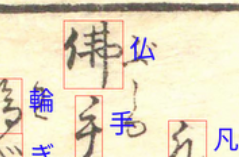

如果原始图像不包含透明度通道，那么将其转换为 RGBA 模式并不会产生明显的影响。但是，这样做可以确保代码的通用性和一致性，以便能够处理包含透明度通道的图像，无论是否当前图像需要透明度效果。

#### ImageDraw相关
bbox_canvas = Image.new('RGBA', imsource.size)创建了一个与原始图像（imsource）相同尺寸的RGBA模式画布，用于绘制边界框（bounding box）。
在计算机图形学中，画布（Canvas）是一个用于绘制图形的虚拟平面或区域。它可以被视为一个空白的画布或绘图板，你可以在上面绘制各种形状、图像和文本等元素。

ImageDraw.Draw(bbox_canvas)创建了一个与bbox_canvas关联的ImageDraw对象，用于在画布上进行绘制操作。

综合起来，上述代码段创建了一个用于绘制边界框的画布（bbox_canvas），并创建了一个与该画布关联的绘图对象（bbox_draw），以便后续可以使用绘图对象在画布上绘制边界框。这种分离的方式可确保绘制的边界框不会覆盖字符，因为它们将被绘制在不同的画布上。

ImageDraw是PIL（Python Imaging Library）库中的一个模块，用于在图像上进行绘图操作。它提供了一组函数和方法，可以绘制线条、矩形、多边形、文本等图形元素，并对图像进行各种绘制操作。

通过导入ImageDraw模块，我们可以创建一个ImageDraw对象，然后使用该对象的方法来在图像上进行绘图。例如，可以使用Draw.rectangle()方法绘制矩形，Draw.line()方法绘制线条，Draw.text()方法绘制文本等。这些方法接受不同的参数来定义绘制的位置、尺寸、颜色等属性。

在上述代码段中，bbox_draw = ImageDraw.Draw(bbox_canvas)创建了一个与bbox_canvas关联的ImageDraw对象，使我们可以使用bbox_draw对象的方法在bbox_canvas画布上进行绘图操作，例如绘制边界框和文本。

<b>代码理解：<br>
    bbox_draw.rectangle((x, y, x+w, y+h), fill=(255, 255, 255, 0), outline=(255, 0, 0, 255))什么意思？
   
这行代码使用bbox_draw对象的rectangle()方法绘制一个矩形。参数(x, y, x+w, y+h)指定了矩形的左上角和右下角坐标，即矩形的左上角点为(x, y)，右下角点为(x+w, y+h)。fill=(255, 255, 255, 0)指定了矩形的填充颜色，这里使用RGBA格式的颜色表示，(255, 255, 255, 0)表示完全透明的白色。outline=(255, 0, 0, 255)指定了矩形的边框颜色，同样使用RGBA格式的颜色表示，(255, 0, 0, 255)表示红色不透明的边框。所以，该行代码的作用是在画布上绘制一个矩形，具有指定的位置、尺寸、填充颜色和边框颜色。

<b>代码理解：<br>
    char_draw.text((x + w + fontsize/4, y + h/2 - fontsize), char, fill=(0, 0, 255, 255), font=font)什么意思？
   
这行代码使用char_draw对象的text()方法在画布上绘制文本。参数(x + w + fontsize/4, y + h/2 - fontsize)指定了文本的起始位置，即文本左上角的坐标。
char是要绘制的文本内容，即Unicode字符。fill=(0, 0, 255, 255)指定了文本的颜色，同样使用RGBA格式的颜色表示，(0, 0, 255, 255)表示不透明的蓝色。
font=font指定了文本的字体，其中font是一个字体对象。所以，该行代码的作用是在画布上绘制指定位置、指定内容和样式的文本。

#### 四维通道α合成
   imsource = Image.alpha_composite(Image.alpha_composite(imsource, bbox_canvas), char_canvas)<br>   
Image.alpha_composite()函数是将两个图像进行alpha合成的函数，它会根据两个图像的alpha通道值进行混合。首先，将imsource图像与bbox_canvas进行合成，生成一个新的图像；然后，将该新图像与char_canvas进行合成，再次生成一个新的图像。最终得到的图像被赋值给变量imsource。
通过这个步骤，将绘制在bbox_canvas和char_canvas上的边界框和字符叠加到原始图像imsource上，形成了包含边界框和字符的新图像。

In [75]:
def visualize_training_data2(image_fn, labels): # 输入照片名称和对应照片的labels（annotation），一个在训练集里面，一个在train.csv的第二列
    # Convert annotation string to array
    labels = np.array(labels.split(' ')).reshape(-1, 5) # 用空格截断labels，转化为数组，再变成一个五列X行的新列表。
    
    # Read image
    imsource = Image.open(image_fn).convert('RGBA')
    
    # 创建两个 RGBA 模式的画布，一个用于绘制边界框（bbox_canvas），另一个用于绘制字符（char_canvas）。这样可以确保边界框不会截断字符。
    # 这里只是创建画布，还没有实际标注呢，在下面
    bbox_canvas = Image.new('RGBA', imsource.size)
    char_canvas = Image.new('RGBA', imsource.size)
    bbox_draw = ImageDraw.Draw(bbox_canvas) # Separate canvases for boxes and chars so a box doesn't cut off a character
    char_draw = ImageDraw.Draw(char_canvas)

    for codepoint, x, y, w, h in labels:
        x, y, w, h = int(x), int(y), int(w), int(h)
        char = unicode_map[codepoint] # Convert codepoint to actual unicode character直接从表格里根据关键词codepoint拿就是了，异常简单。

        # Draw bounding box around character, and unicode character next to it 实际标注过程
        bbox_draw.rectangle((x, y, x+w, y+h), fill=(255, 255, 255, 0), outline=(255, 0, 0, 255))
        char_draw.text((x + w + fontsize/4, y + h/2 - fontsize), char, fill=(0, 0, 255, 255), font=font)
    # 在bbox_canvas和char_canvas上的边界框和字符叠加到原始图像imsource上，形成了包含边界框和字符的新图像。
    imsource = Image.alpha_composite(Image.alpha_composite(imsource, bbox_canvas), char_canvas)
    imsource = imsource.convert("RGB") # Remove alpha for saving in jpg format.
    return np.asarray(imsource) # 将图像对象（PIL） imsource 转换为 NumPy 数组

<b>这里input_path/'train_images/{}.jpg'.format(img名称)的写法很好，学习

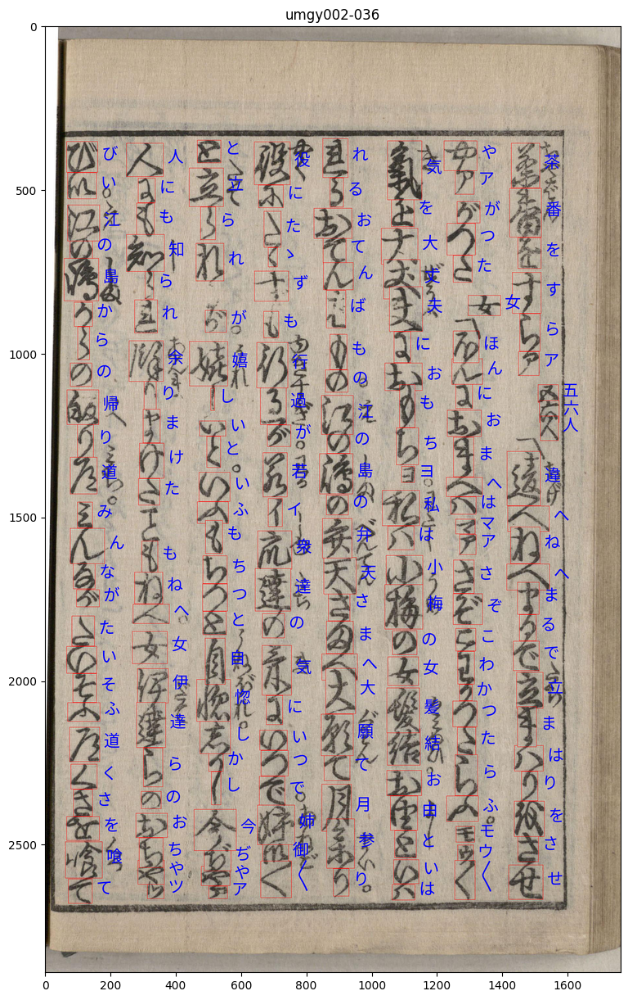

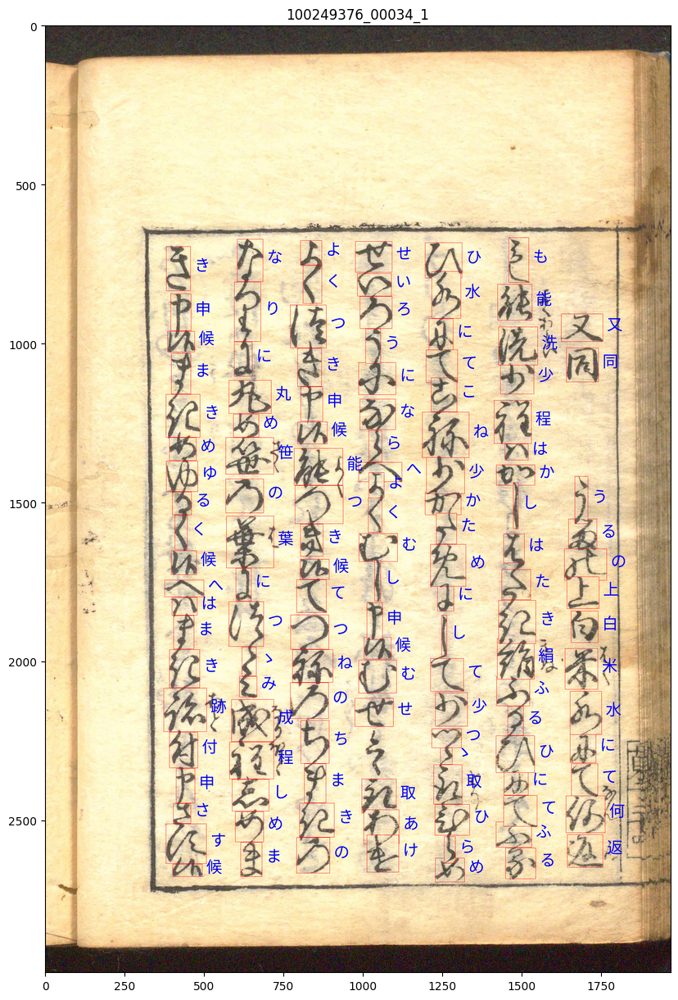

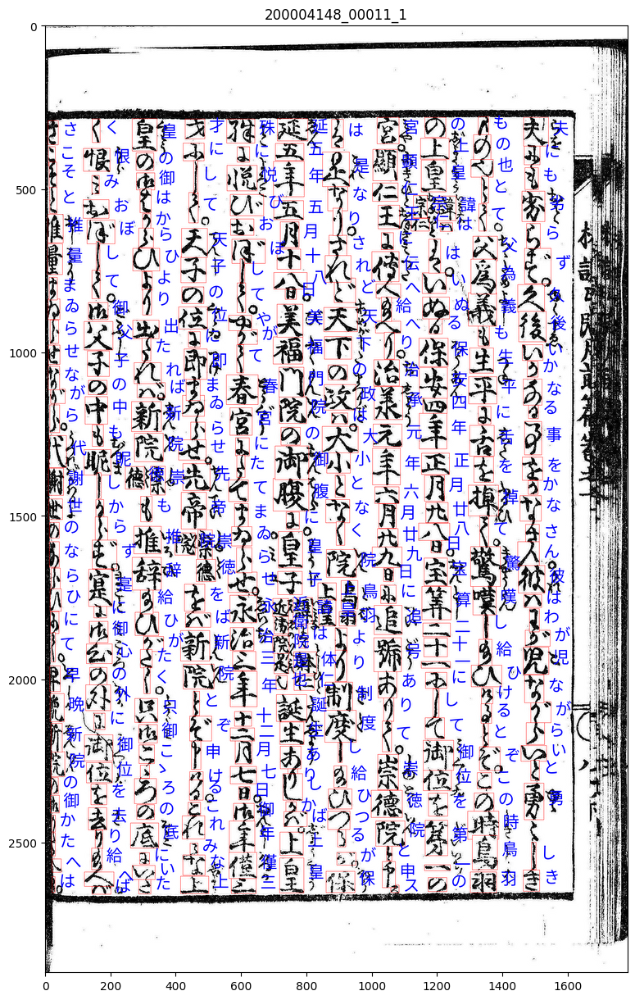

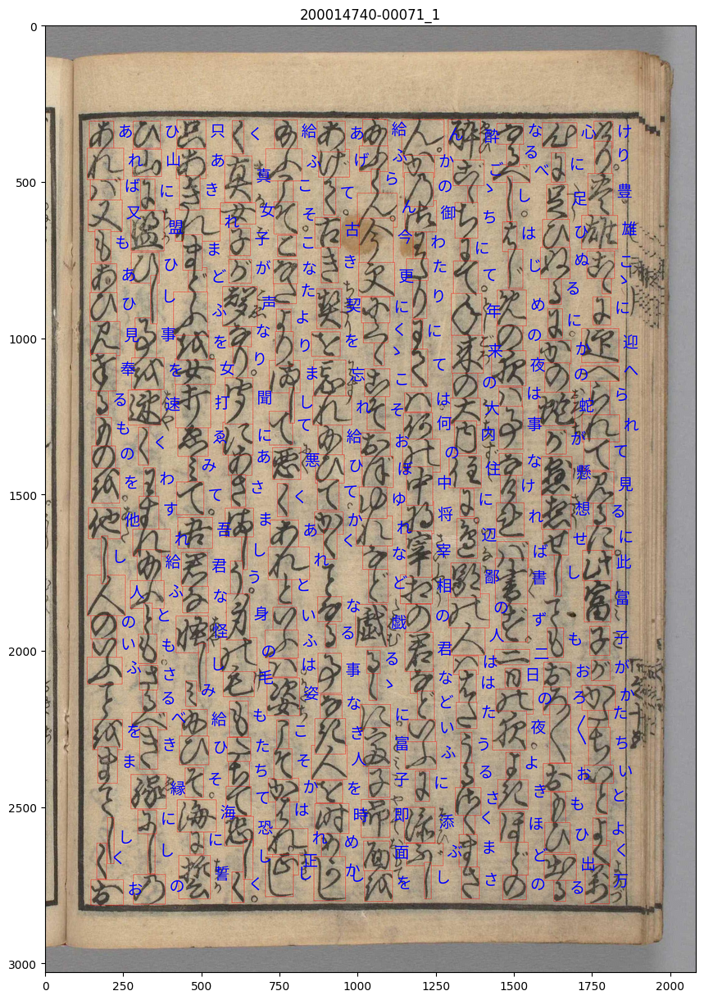

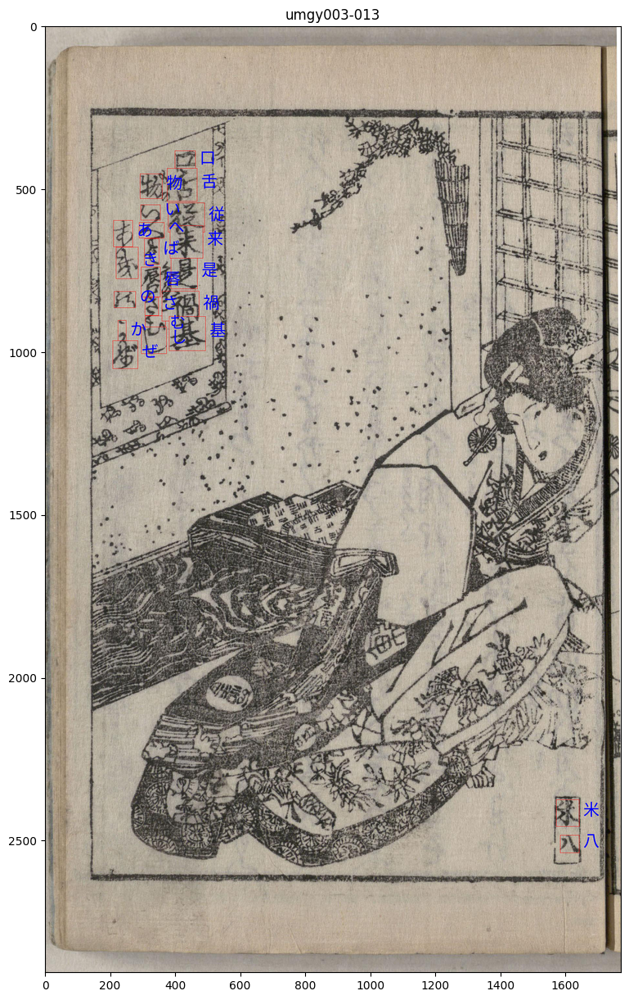

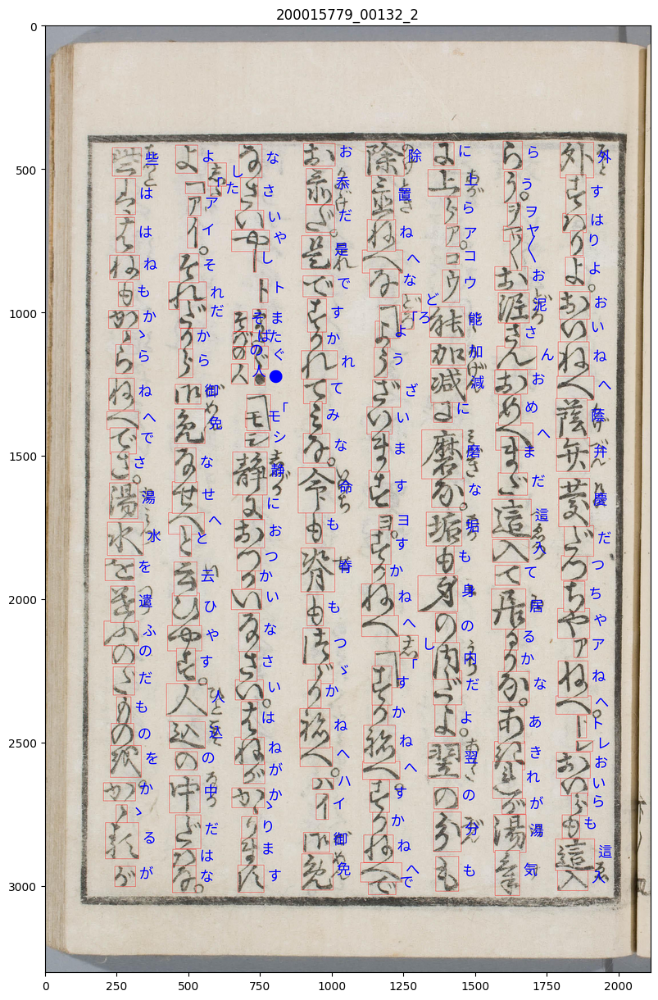

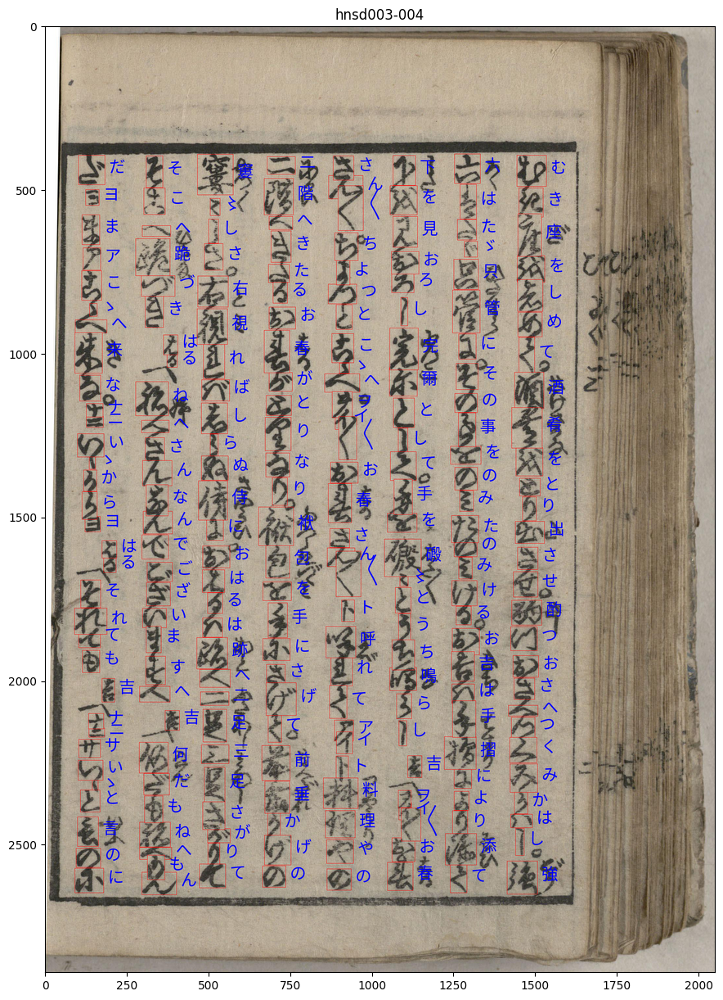

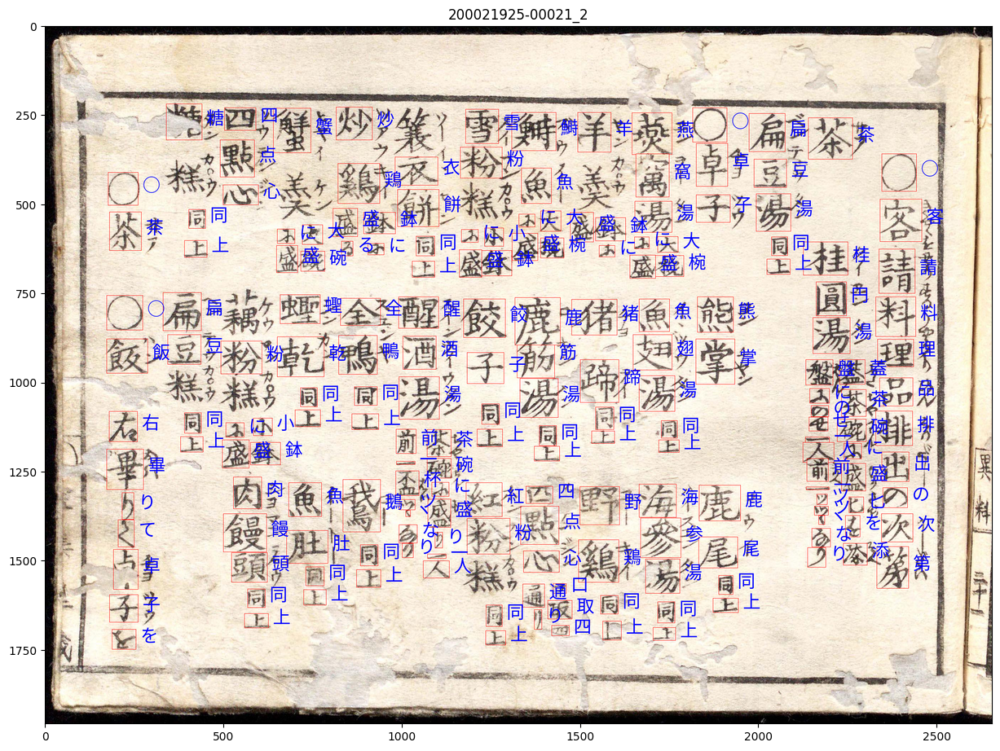

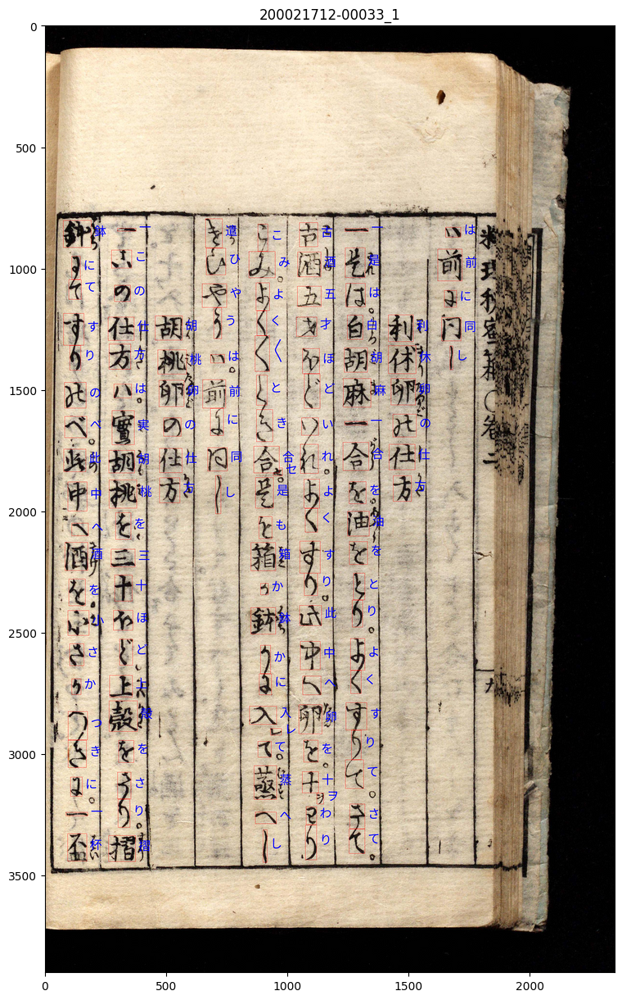

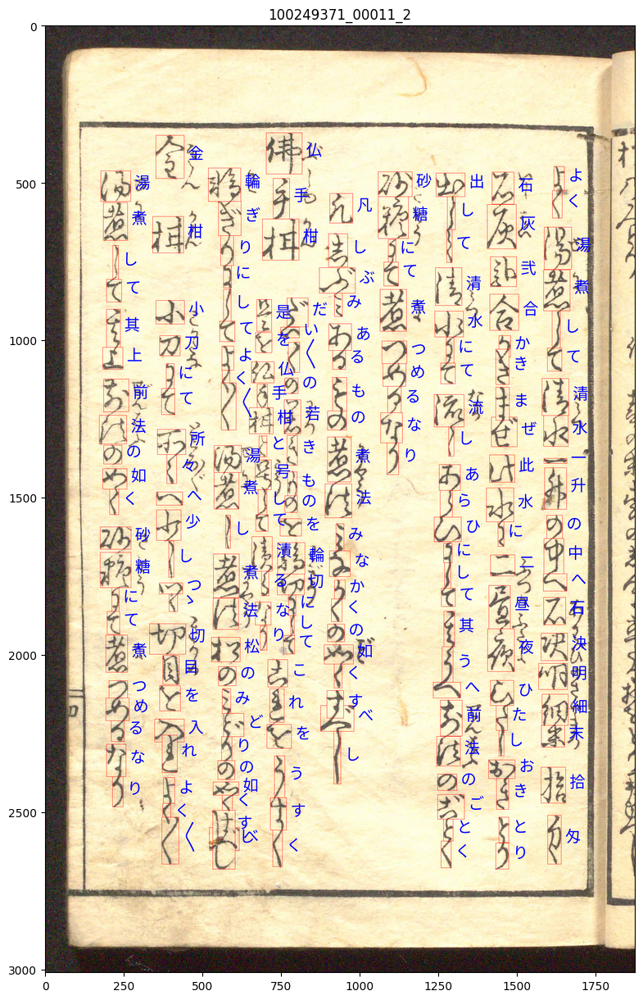

In [76]:
np.random.seed(1337)

for i in range(10):
    image_fn, labels = df_train.values[np.random.randint(len(df_train))] # 从train.csv中获取某一张照片名字和它对应的标注labels
    viz = visualize_training_data2(input_path/'train_images/{}.jpg'.format(image_fn), labels)  # 输入图像路径和标注，返回numpy数组形式的处理好的图片
    
    plt.figure(figsize=(15, 15))# 创建一个具有指定尺寸的新的 Matplotlib 图形对象。创建的图形将具有宽度为 15 英寸，高度为 15 英寸的尺寸。
    plt.title(image_fn) # 标题输入图像名称
    plt.imshow(viz, interpolation='lanczos') # 注意，imshow必须接受numpyarray类型！PIL是不行的！另外插值算法是 lanczos
    plt.show()

## 输出预测结果
对于测试集，您只需要预测每个边界框内的单个点，而不是整个边界框(理想情况下，是边界框的中心)。 因此可视化图像上的框中心也可能很有用。

In [1]:
# This function takes in a filename of an image, and the labels in the string format given in a submission csv, and returns an image with the characters and predictions annotated.
def visualize_predictions(image_fn, labels):
    # Convert annotation string to array
    labels = np.array(labels.split(' ')).reshape(-1, 3)
    
    # Read image
    imsource = Image.open(image_fn).convert('RGBA')
    bbox_canvas = Image.new('RGBA', imsource.size)
    char_canvas = Image.new('RGBA', imsource.size)
    bbox_draw = ImageDraw.Draw(bbox_canvas) # Separate canvases for boxes and chars so a box doesn't cut off a character
    char_draw = ImageDraw.Draw(char_canvas)

    for codepoint, x, y in labels:
        x, y = int(x), int(y)
        char = unicode_map[codepoint] # Convert codepoint to actual unicode character

        # Draw bounding box around character, and unicode character next to it
        bbox_draw.rectangle((x-10, y-10, x+10, y+10), fill=(255, 0, 0, 255))
        char_draw.text((x+25, y-fontsize*(3/4)), char, fill=(255, 0, 0, 255), font=font)

    imsource = Image.alpha_composite(Image.alpha_composite(imsource, bbox_canvas), char_canvas)
    imsource = imsource.convert("RGB") # Remove alpha for saving in jpg format.
    return np.asarray(imsource)

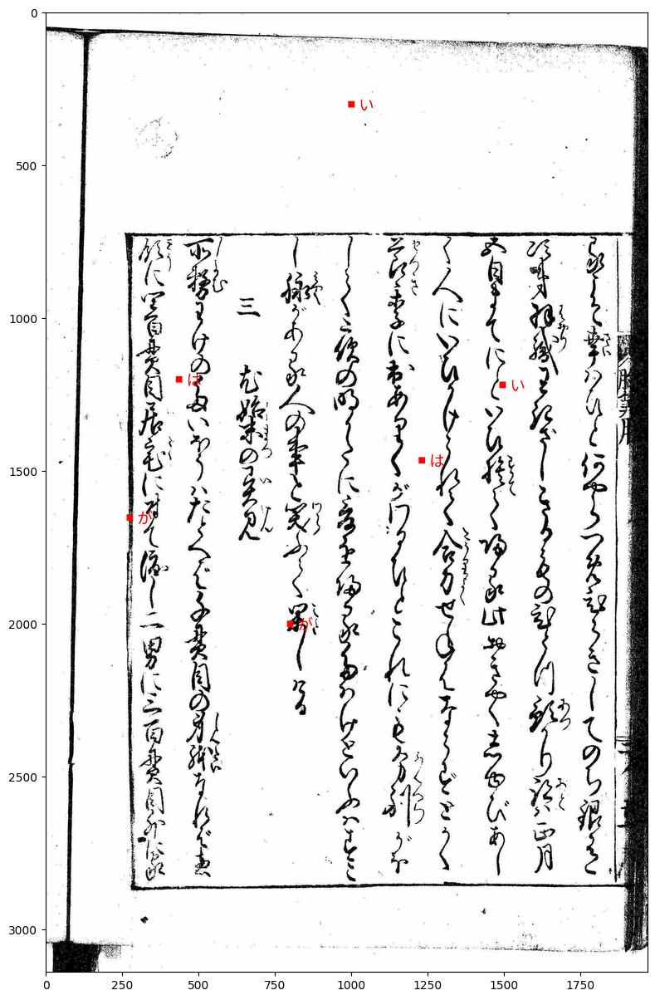

In [16]:
image_fn = input_path/'test_images'/'test_0b7ecb9d.jpg'
pred_string = 'U+306F 1231 1465 U+304C 275 1652 U+3044 1495 1218 U+306F 436 1200 U+304C 800 2000 U+3044 1000 300' # Prediction string in submission file format
viz = visualize_predictions(image_fn, pred_string)

plt.figure(figsize=(15, 15))
plt.imshow(viz, interpolation='lanczos')